In [1]:
import numpy as np
import pandas as pd
import sdv
#import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
real_data=pd.read_csv('UCI_Credit_Card.csv')
real_data.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [3]:
real_data[['SEX','EDUCATION','MARRIAGE','default.payment.next.month']]=real_data[['SEX','EDUCATION','MARRIAGE','default.payment.next.month']].astype(str)

In [4]:
from sdv.metadata import SingleTableMetadata
metadata = SingleTableMetadata.load_from_json(
    filepath='metadata (copy).json') # loading the metadata

In [5]:
metadata.set_primary_key(column_name='ID') #since ID always take unique value

In [6]:
metadata

{
    "METADATA_SPEC_VERSION": "SINGLE_TABLE_V1",
    "primary_key": "ID",
    "columns": {
        "ID": {
            "sdtype": "numerical",
            "computer_representation": "Int64"
        },
        "LIMIT_BAL": {
            "sdtype": "numerical",
            "computer_representation": "Float"
        },
        "SEX": {
            "sdtype": "categorical"
        },
        "EDUCATION": {
            "sdtype": "categorical"
        },
        "MARRIAGE": {
            "sdtype": "categorical"
        },
        "AGE": {
            "sdtype": "numerical",
            "computer_representation": "Int64"
        },
        "PAY_0": {
            "sdtype": "numerical",
            "computer_representation": "Int64"
        },
        "PAY_2": {
            "sdtype": "numerical",
            "computer_representation": "Int64"
        },
        "PAY_3": {
            "sdtype": "numerical",
            "computer_representation": "Int64"
        },
        "PAY_4": {
            "sd

## LOADING TVAE GENERATED DATA

In [7]:
from sdv.single_table import TVAESynthesizer
TVAESynthesizer = TVAESynthesizer(metadata)
synthesizerTVAE = TVAESynthesizer.load(
    'my_TVAE_synthesizer.pkl'
)

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\base.py:318: UserWarning: Trying to unpickle estimator BayesianGaussianMixture from version 1.2.1 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [8]:
synthetic_dataTVAE = synthesizerTVAE.sample(30000)

In [9]:
synthetic_dataTVAE

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,10,235356.0,2,2,2,32,0,0,0,0,...,45353.0,11040.0,682.0,2367.0,3982.0,14942.0,5647.0,10700.0,11596.0,0
1,11,149361.0,2,2,2,27,2,0,2,2,...,92572.0,92904.0,77226.0,1225.0,377.0,4693.0,7179.0,3291.0,2651.0,0
2,12,156315.0,2,1,1,30,1,-2,-2,-2,...,2171.0,833.0,302.0,320.0,0.0,116.0,0.0,143.0,337.0,1
3,13,46365.0,2,1,2,31,1,2,2,2,...,24584.0,20384.0,20429.0,0.0,965.0,1031.0,183.0,652.0,0.0,1
4,14,104492.0,2,1,2,36,-1,-1,-1,-1,...,702.0,1418.0,-577.0,1720.0,1054.0,0.0,122.0,161.0,433.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,30005,330879.0,2,1,2,34,0,0,0,0,...,24574.0,25419.0,30711.0,4497.0,3915.0,2072.0,3741.0,6919.0,4721.0,0
29996,30006,131224.0,2,2,2,31,0,0,0,0,...,82896.0,38185.0,27626.0,634.0,1796.0,3223.0,216.0,3853.0,1750.0,0
29997,30007,129127.0,2,1,1,31,-1,-1,-1,-1,...,2360.0,-1155.0,982.0,820.0,0.0,327.0,0.0,0.0,434.0,0
29998,30008,140057.0,2,2,1,40,-1,-1,-2,-1,...,-1460.0,-988.0,779.0,244.0,210.0,0.0,398.0,725.0,123.0,0


In [10]:
synthetic_dataTVAE.describe(include='all')

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,30000.000000,30000.000000,30000,30000,30000,30000.000000,30000.00000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.00000,30000.000000,30000.000000,30000.000000,30000
unique,NaN,NaN,2,3,2,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,NaN,NaN,2,2,2,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
freq,NaN,NaN,26866,18628,22538,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26176
mean,15009.500000,145749.023933,NaN,NaN,NaN,31.820267,0.02090,-0.000267,-0.063367,-0.182467,...,38046.254100,31881.797500,31445.584367,5290.820700,5603.517833,4152.20970,3741.651367,3411.281133,2261.248033,NaN
std,8660.398374,117103.615812,NaN,NaN,NaN,5.814610,1.04927,1.253124,1.256345,1.227364,...,55269.529069,46046.999185,46572.021330,11861.335224,13434.883002,13484.93365,9647.480644,7970.140747,4742.677133,NaN
min,10.000000,10000.000000,NaN,NaN,NaN,21.000000,-2.00000,-2.000000,-2.000000,-2.000000,...,-170000.000000,-81334.000000,-27567.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,NaN
25%,7509.750000,53489.750000,NaN,NaN,NaN,28.000000,-1.00000,-1.000000,-1.000000,-1.000000,...,1318.750000,1276.000000,885.000000,754.000000,707.000000,294.00000,294.000000,125.750000,117.000000,NaN
50%,15009.500000,124379.500000,NaN,NaN,NaN,31.000000,0.00000,0.000000,0.000000,0.000000,...,17725.500000,14397.000000,14563.500000,1937.000000,1814.000000,1122.00000,1186.000000,999.000000,675.000000,NaN
75%,22509.250000,175622.250000,NaN,NaN,NaN,35.000000,1.00000,0.000000,0.000000,0.000000,...,51516.000000,43765.000000,44615.250000,4535.250000,4539.000000,3288.00000,2925.250000,3024.000000,2518.000000,NaN


One problem is that id value has started from 10 instead of 0. After directly generating data , this problem does not happen. 

## LOADING GAN GENERATED DATA

In [11]:
from sdv.single_table import CTGANSynthesizer

synthesizerCTGAN = CTGANSynthesizer.load(
    'my_CTGAN_synthesizer.pkl'
)

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\base.py:318: UserWarning: Trying to unpickle estimator BayesianGaussianMixture from version 1.2.1 when using version 1.2.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(


In [12]:
synthetic_dataCTGAN = synthesizerCTGAN.sample(num_rows=30000)

In [13]:
synthetic_dataCTGAN

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,300,209160.0,1,3,2,42,1,2,0,-1,...,135.0,542.0,1431.0,1332.0,1321.0,4986.0,2918.0,5898.0,1355.0,0
1,301,22584.0,1,3,2,38,0,0,0,0,...,13147.0,24288.0,19531.0,1892.0,3734.0,1161.0,1820.0,2508.0,1120.0,1
2,302,73605.0,1,1,2,34,1,2,2,2,...,158318.0,11758.0,16088.0,21772.0,10815.0,13716.0,6554.0,12015.0,351.0,1
3,303,22762.0,2,3,3,55,2,2,0,0,...,3824.0,4721.0,13740.0,692.0,792.0,4780.0,454.0,4894.0,1570.0,1
4,304,17098.0,1,3,2,29,0,0,0,0,...,10680.0,11969.0,4464.0,990.0,0.0,347.0,473.0,1549.0,315.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,30295,201094.0,2,3,0,23,1,-1,-1,-1,...,10804.0,288.0,1472.0,7371.0,938.0,6806.0,772.0,8.0,345.0,0
29996,30296,25545.0,2,5,1,31,0,0,0,0,...,9129.0,21220.0,13016.0,3219.0,3066.0,3773.0,610.0,4052.0,40.0,0
29997,30297,44495.0,1,0,2,35,0,0,0,0,...,-790.0,-1264.0,-738.0,956.0,520.0,517.0,726.0,63.0,203.0,0
29998,30298,267364.0,1,2,2,23,0,-1,0,0,...,5957.0,13324.0,4028.0,2365.0,2008.0,379.0,1437.0,2523.0,1953.0,0


In [14]:
synthetic_dataCTGAN.describe(include='all')

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
count,30000.000000,30000.000000,30000,30000,30000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,...,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000
unique,NaN,NaN,2,7,4,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,NaN,NaN,1,2,2,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
freq,NaN,NaN,15142,9996,15937,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23828
mean,15299.500000,165635.718133,NaN,NaN,NaN,35.691667,0.029500,-0.160267,-0.232867,-0.280633,...,47305.309300,43173.578500,40970.076767,5718.010467,6805.082433,6101.730767,4595.698800,4917.471767,4951.272633,NaN
std,8660.398374,127430.454369,NaN,NaN,NaN,9.400043,1.010543,1.158804,1.123602,1.103261,...,72307.385082,67060.840451,64940.846088,10862.371122,16323.857006,16000.641683,10963.780036,12785.439547,14343.609218,NaN
min,300.000000,10000.000000,NaN,NaN,NaN,21.000000,-2.000000,-2.000000,-2.000000,-2.000000,...,-16481.000000,-27300.000000,-6637.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,7799.750000,58310.000000,NaN,NaN,NaN,29.000000,0.000000,-1.000000,-1.000000,-1.000000,...,2032.000000,1633.000000,949.000000,1158.000000,977.000000,747.750000,554.000000,224.000000,258.000000,NaN
50%,15299.500000,140626.500000,NaN,NaN,NaN,35.000000,0.000000,0.000000,0.000000,0.000000,...,17304.000000,16942.000000,17346.000000,2270.000000,2156.000000,2589.500000,1857.500000,1648.000000,1412.500000,NaN
75%,22799.250000,242277.500000,NaN,NaN,NaN,42.000000,0.000000,0.000000,0.000000,0.000000,...,56659.250000,53725.000000,47336.750000,5115.000000,5245.000000,5920.000000,4423.000000,4980.000000,3578.000000,NaN


## OVERALL  QUALITY

Overall quality is the overall score of how our synthetic data is mathematically close to real dataset.It is the average of column shape score and column pair trends.

1.
..
 **COLUMN SHAPE**
..
For numerical and date time variable we use KSComplement.

KSComplement : This metric computes the similarity of a real column vs. a synthetic column in terms of the column shapes -- aka the marginal distribution or 1D histogram of the column.
This metric ignores missing values.
The KSComplement uses the Kolmogorov-Smirnov statistic . To compute this statistic, we convert a numerical distribution into its cumulative distribution function (CDF) . The [KS statistic] is the maximum difference between the two CDFs.The distance is a value between 0 and 1. In SDMetrics, it is inverted: The KSComplement returns 1-(KS statistic) so that a higher score means higher quality.

For categorical variable, we have used TVComplment.

TVComplment: 
This metric computes the similarity of a real column vs. a synthetic column in terms of the column shapes -- aka the marginal distribution or 1D histogram of the column.
This test computes the Total Variation Distance (TVD) between the real and synthetic columns. To do this, it first computes the frequency of each category value and expresses it as a probability. The TVD statistic compares the differences in probabilities, as shown in the formula below
      


   $$\beta(R,S) =1/2*\sum(\lvert R_\omega- S_w \rvert)$$

here $\omega$ describes all the possible categories in a column.Meanwhile, $R$ and $S$ refer to the real and synthetic frequencies for those categories. The TVComplement returns $ 1- TVD $ as score, so that a higher score means higher quality.

 $$score = 1- \beta(R,S)$$

### TVAE

In [46]:
from sdv.evaluation.single_table import evaluate_quality

quality_report1 = evaluate_quality(
    real_data,
    synthetic_dataTVAE,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:05<00:00,  1.35s/it]



Overall Quality Score: 89.43%

Properties:
Column Shapes: 88.55%
Column Pair Trends: 90.31%


In [47]:
from sdv.evaluation.single_table import evaluate_quality

quality_report2 = evaluate_quality(
    real_data,
    synthetic_dataCTGAN,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:04<00:00,  1.19s/it]



Overall Quality Score: 93.56%

Properties:
Column Shapes: 92.03%
Column Pair Trends: 95.1%


Here , CTGAN and TVAE both performs better than GaussianCopula method. GaussianCopula has a score 86.98% as overall quality score. Column pair trends is approximately same for TVAE and Gaussian Copula.
CTGAN has a lead copmpared to others.

  

### Column Shape

In [48]:
#Report Visualization TVAE
#Column Shapes
fig=quality_report1.get_visualization(property_name='Column Shapes')
fig.show()

In [49]:
#TVAE
rpt_tvae=quality_report1.get_details('Column Shapes')
rpt_tvae

,Column,Metric,Quality Score
0,LIMIT_BAL,KSComplement,0.823700
1,AGE,KSComplement,0.788433
2,PAY_0,KSComplement,0.938300
3,PAY_2,KSComplement,0.928000
4,PAY_3,KSComplement,0.937667
5,PAY_4,KSComplement,0.953167
6,PAY_5,KSComplement,0.953167
7,PAY_6,KSComplement,0.948667
8,BILL_AMT1,KSComplement,0.933900
9,BILL_AMT2,KSComplement,0.948867


In [50]:
#CTGAN
fig=quality_report2.get_visualization(property_name='Column Shapes')
fig.show()

In [51]:
rpt_gan=quality_report2.get_details('Column Shapes')
rpt_gan

,Column,Metric,Quality Score
0,LIMIT_BAL,KSComplement,0.928933
1,AGE,KSComplement,0.939033
2,PAY_0,KSComplement,0.939267
3,PAY_2,KSComplement,0.987900
4,PAY_3,KSComplement,0.969433
5,PAY_4,KSComplement,0.951867
6,PAY_5,KSComplement,0.968900
7,PAY_6,KSComplement,0.977700
8,BILL_AMT1,KSComplement,0.940200
9,BILL_AMT2,KSComplement,0.930700


For TVAE SEX, MARRIAGE and AGE has the lowest score, for CTGAN PAY_AMT4,EDUCATION,PAY_AMT3 are the worst one.
Comparing to Gaussian Copula , all categorical columns have score between 0.90 to 0.95 and they are among  the best columns .
Maybe , Gaussian Copula performs better than TVAE and CTGAN for categorical variables. 

## COLUMN PAIR TRENDS

CorrelationSimilarity:
This metric measures the correlation between a pair of numerical columns and computes the similarity between the real and synthetic data -- aka it compares the trends of 2D distributions. This metric supports both the Pearson and Spearman's rank coefficients to measure correlation.
We have used  Pearson correlation coefficient here.

For a pair of columns, A and B, this test computes a correlation coefficient on the real and synthetic data, R and S. This yields two separate correlation values. The test normalizes and returns a similarity score using the formula below.
$$score = 1-(1/2)*(\lvert R_{A,B}-S_{A,B} \rvert)$$


ContingencySimilarity:

This metric computes the similarity of a pair of categorical columns between the real and synthetic datasets -- aka it compares 2D distributions.
For a pair of columns, A and B, the test computes a normalized contingency table , for the real and synthetic data. This table describes the proportion of rows that have each combination of categories in A and B.
Then, it computes the difference between the contingency tables using the Total Variation Distance . Finally, we subtract the distance from 1 to ensure that a high score means high similarity. The process is summarized by the formula below.

$$score =1- (1/2)*\sum_{α}\sum_{β}(\lvert R_{α, β}-S_{α, β} \rvert)$$

In the formula, α describes all the possible categories in column A and β describes all the possible categories in column B. Meanwhile, R and S refer to the real and synthetic frequencies for those categories.

 ****Question**** it measures correlation between any two columns but can we say that the correlation between more than  two columns is also satisfied?

In [52]:
#TVAE
fig=quality_report1.get_visualization(property_name='Column Pair Trends')
fig.show()

In [53]:
#CTGAN
fig=quality_report2.get_visualization(property_name='Column Pair Trends')
fig.show()

In [54]:
#TVAE
quality_report1.get_details('Column Pair Trends').sort_values('Quality Score')

,Column 1,Column 2,Metric,Quality Score,Real Correlation,Synthetic Correlation
190,EDUCATION,SEX,ContingencySimilarity,0.600800,NaN,NaN
197,EDUCATION,LIMIT_BAL,ContingencySimilarity,0.630067,NaN,NaN
200,AGE,SEX,ContingencySimilarity,0.635133,NaN,NaN
196,LIMIT_BAL,SEX,ContingencySimilarity,0.642133,NaN,NaN
191,MARRIAGE,SEX,ContingencySimilarity,0.652133,NaN,NaN
...,...,...,...,...,...,...
109,PAY_5,PAY_AMT4,CorrelationSimilarity,0.999222,-0.058299,-0.056744
102,BILL_AMT3,PAY_5,CorrelationSimilarity,0.999225,0.243335,0.244884
156,BILL_AMT4,PAY_AMT1,CorrelationSimilarity,0.999502,0.233012,0.232016
40,PAY_0,PAY_5,CorrelationSimilarity,0.999586,0.509426,0.508598


In [55]:
#CTGAN
quality_report2.get_details('Column Pair Trends').sort_values('Quality Score')

,Column 1,Column 2,Metric,Quality Score,Real Correlation,Synthetic Correlation
190,EDUCATION,SEX,ContingencySimilarity,0.797233,NaN,NaN
220,EDUCATION,PAY_0,ContingencySimilarity,0.799667,NaN,NaN
222,EDUCATION,PAY_3,ContingencySimilarity,0.807133,NaN,NaN
219,AGE,EDUCATION,ContingencySimilarity,0.808100,NaN,NaN
197,EDUCATION,LIMIT_BAL,ContingencySimilarity,0.814533,NaN,NaN
...,...,...,...,...,...,...
40,PAY_0,PAY_5,CorrelationSimilarity,0.998763,0.509426,0.511900
28,AGE,BILL_AMT4,CorrelationSimilarity,0.998950,0.051353,0.053453
172,BILL_AMT6,PAY_AMT4,CorrelationSimilarity,0.999176,0.250237,0.248588
79,PAY_3,PAY_AMT1,CorrelationSimilarity,0.999218,0.001295,-0.000268


CTGAN has a higher score than TVAE and also GaussianCopula. ContingencySimilarity is low for all three methos, worst for Gaussian copula.

## Visualization of distribution:

First check the distribution of BILL_AMT1 for CTGAN and TVAE methods. BILL_AMT1 has the lowest score 0.6 for Gaussian Copula method.For copula,kurtosis and skewness differed but here for CTGAN and TVAE both has a good score and the kurtosis has improved a lot and also covers some extreme values.For TVAE and CTGAN its score 0.94.


### BILL _AMT1

In [56]:
#TVAE
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='BILL_AMT1',
    metadata=metadata
)



In [57]:
get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='BILL_AMT1',
    metadata=metadata
)

In [58]:
real_data['BILL_AMT1'].describe()

count     30000.000000
mean      51223.330900
std       73635.860576
min     -165580.000000
25%        3558.750000
50%       22381.500000
75%       67091.000000
max      964511.000000
Name: BILL_AMT1, dtype: float64

Lets check how close stat prop of synthetic data

In [59]:
synthetic_dataTVAE['BILL_AMT1'].describe()

count     30000.000000
mean      45890.865000
std       62741.135508
min      -11483.000000
25%        3011.750000
50%       24537.000000
75%       60935.500000
max      646164.000000
Name: BILL_AMT1, dtype: float64

In [60]:
synthetic_dataCTGAN['BILL_AMT1'].describe()

count     30000.000000
mean      55081.373700
std       88151.292767
min       -7829.000000
25%        2699.750000
50%       22018.000000
75%       60204.500000
max      691850.000000
Name: BILL_AMT1, dtype: float64

CTGAN has a closer mean , TVAE has a better std but none of methods able to guess the maximum value of real data.Hence they are unable to generate  extreme values.
Also another problem is that , the distribution looks like someone has sliced it(!) 

In [61]:
#check the distribution column wise
#SEX,AGE,MARRIAGE,EDUCATION WORST ONE FOR TVAE
#SEX COLUMN TVAE

### SEX

In [62]:
#tvae
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='SEX',
    metadata=metadata
)



Clearly , TVAE unable to generate close freequencies for SEX columns. The difference between these two categories , for TVAE is high but for real data it' s not .
TVAE fails to capture this.

In [63]:
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='SEX',
    metadata=metadata
)



CTGAN predicts that that these categories has almost same freequency but for real data it's not . But comparing to TVAE, the difference is totally in oppposite direction but CTGAN performs better.
But Gaussian Copula has captured almost same freequency as real data for this variable

### EDUCATION

In [64]:
#TVAE
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='EDUCATION',
    metadata=metadata
)



In [65]:
#CTGAN
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='EDUCATION',
    metadata=metadata
)



TVAE misses 5,4,6,0 categories totally .So this may have  a negetive impact where all the catgories are  captured by CTGAN but 1 ,2 category is predicted has same frequency , but not in real dataset. Also, in real dataset 0 category has the lowest freeuency but CTGAN is unable to predict that. 

### AGE

In [66]:
#TVAE
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='AGE',
    metadata=metadata
)



AGE 30 has a frequency value as 0.08 for synthetic data but it's 0.05. also after AGE 40, for synthetic data frequency declines heavily and data contains a low amount of data for age 50 to 60 compared to real dataset.

In [67]:
#CTGAN
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='AGE',
    metadata=metadata
)



Like TVAE , CTGAN does not predict frequency so bad but looking pdf, it does not seem like they belong to the same distribution.After age 23 the pdf suddenly declines and after age 27 it again goes upward. 29 age has the highst value for real data but for ctgan generated data it's 33.

In [68]:
#PAY_AMT4,EDUCATION ,PAY_AMT3 ARE THE WORST ONE FOR CTGAN
#CHECK DISTRIBUTIO PAY_AMT4
#TVAE
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='PAY_AMT4',
    metadata=metadata
)



In [69]:
#CTGAN
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='PAY_AMT4',
    metadata=metadata
)



CTGAN has captured the extreme values at some extent but its distance from real distribution is high than the TVAE genrated distribution. But TVAE is unable to capture the extreme values.
If extreme values are important for us then TVAE will be a bad choice over CTGAN 

In [70]:
#EDUCATION
#TVAE
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_name='EDUCATION',
    metadata=metadata
)



In [71]:
#CTGAN
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_name='EDUCATION',
    metadata=metadata
)



### COLUMN PAIR TRENDS

In [72]:
#tvae
tv=quality_report1.get_details('Column Pair Trends')
tv.sort_values(by ='Quality Score')


,Column 1,Column 2,Metric,Quality Score,Real Correlation,Synthetic Correlation
190,EDUCATION,SEX,ContingencySimilarity,0.600800,NaN,NaN
197,EDUCATION,LIMIT_BAL,ContingencySimilarity,0.630067,NaN,NaN
200,AGE,SEX,ContingencySimilarity,0.635133,NaN,NaN
196,LIMIT_BAL,SEX,ContingencySimilarity,0.642133,NaN,NaN
191,MARRIAGE,SEX,ContingencySimilarity,0.652133,NaN,NaN
...,...,...,...,...,...,...
109,PAY_5,PAY_AMT4,CorrelationSimilarity,0.999222,-0.058299,-0.056744
102,BILL_AMT3,PAY_5,CorrelationSimilarity,0.999225,0.243335,0.244884
156,BILL_AMT4,PAY_AMT1,CorrelationSimilarity,0.999502,0.233012,0.232016
40,PAY_0,PAY_5,CorrelationSimilarity,0.999586,0.509426,0.508598


In [73]:
from sdv.evaluation.single_table import get_column_pair_plot

fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_names=['EDUCATION', 'SEX'],
    metadata=metadata
)
    
fig.show()

In [74]:
from sdv.evaluation.single_table import get_column_pair_plot

fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_names=['EDUCATION', 'SEX'],
    metadata=metadata
)
    
fig.show()

ContigencySimmilarity is high for CTGAN as the total variation distance is low for CTGAN comparing to TVAE.
CTGAN performs well than TVAE and also Gaussian copula.

In [75]:
#TVAE
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_names=['SEX', 'LIMIT_BAL'],
    metadata=metadata
)
fig.show()

In [76]:
#CTGAN
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_names=['SEX', 'LIMIT_BAL'],
    metadata=metadata
)
fig.show()

TVAE performs poor for SEX 1 category. CTGAN gives the exact correlation as the original dataset. 

In [77]:
#TVAE
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_names=['EDUCATION', 'PAY_0'],
    metadata=metadata
)
fig.show()

In [78]:
#CTGAN
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_names=['EDUCATION', 'PAY_0'],
    metadata=metadata
)
fig.show()

TVAE unable to predict any data with EDUACTION  4,6,0 so that's a concern and it also effects the correlation similarity as well.

For CTGAN , it's unable to predict some extreme values for PAY_0 column and that's why it misses some outliers as well

In [79]:
#TVAE
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    column_names=['PAY_AMT2', 'PAY_AMT4'],
    metadata=metadata
)
fig.show()

In [80]:
#CTGAN
fig = get_column_pair_plot(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    column_names=['PAY_AMT2', 'PAY_AMT4'],
    metadata=metadata
)
fig.show()

## Diagnostic Report

The Diagnostic Report runs some basic checks on our synthetic data to give a general sense of the strengths and weakness of your synthetic data model. 
Metric name -->'Coverage':

For numerical variable(RangeCoverage): This metric measures whether a synthetic column covers the full range of values that are present in a real column.

If r and s represent the real and synthetic columns, then this metric computes how close the min and max values of s come to the true min and max values in r according to the formula below.
$$score = 1-max[\frac{(min(s)-min(r))}{(max(r)-min(r)},0]+max[\frac{(max(r)-max(s)}{max(r)-min(r)}]$$
Highest value-->1,lowest value-->0

For categorical variable(CategoryCoverage):This has the same meaning as above but for categorical variable.
This metric first computes the number of unique categories, c, that are present in the real column r. Then it computes the number of those categories present in the synthetic column, s. It returns the proportion of real categories that are in the synthetic data.
$$score = \frac {c_s}{c_r}$$


In [81]:
#DIAGNOSTIC REPORT
#TVAE

from sdv.evaluation.single_table import run_diagnostic

diagnostic_report = run_diagnostic(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    metadata=metadata)

Creating report: 100%|██████████████████████████████████████████████████████████████████| 4/4 [06:57<00:00, 104.47s/it]


DiagnosticResults:

SUCCESS:
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data

! The synthetic data is missing more than 10% of the categories present in the real data

DANGER:
x The synthetic data is missing more than 50% of the numerical ranges present in the real data


In [82]:
#DIAGNOSTIC REPORT
#CTGAN

from sdv.evaluation.single_table import run_diagnostic

diagnostic_report2 = run_diagnostic(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    metadata=metadata)

Creating report: 100%|██████████████████████████████████████████████████████████████████| 4/4 [07:20<00:00, 110.12s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the categories present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data

DANGER:
x The synthetic data is missing more than 50% of the numerical ranges present in the real data


As in EDUCATION column we have seen that TVAE missed some categories of real dataset, so it is also diagnosed . But for CTGAN, there is no such report. If all categories is important for data , then we should not use TVAE.
Gaussian Copula has also abled to cover more than 90% of data.
But for numerical ranges, TVAE and CTGAN both failed to cover numerical ranges. Whereas Gaussian Copula misses more than 10% data. Also coverage score is high for Gaussian Copula.

In [83]:
#TVAE
diagnostic_report.get_properties()

{'Coverage': 0.5298457705010241, 'Synthesis': 1.0, 'Boundaries': 1.0}

In [84]:
#CTGAN
diagnostic_report2.get_properties()

{'Coverage': 0.5668162324437361, 'Synthesis': 1.0, 'Boundaries': 1.0}

In [85]:
#TVAE
diagnostic_report.get_details(property_name='Coverage').sort_values('Diagnostic Score')

,Column,Metric,Diagnostic Score
15,PAY_AMT2,RangeCoverage,0.102740
14,PAY_AMT1,RangeCoverage,0.177791
17,PAY_AMT4,RangeCoverage,0.208636
19,PAY_AMT6,RangeCoverage,0.222700
16,PAY_AMT3,RangeCoverage,0.291993
10,BILL_AMT3,RangeCoverage,0.382238
21,EDUCATION,CategoryCoverage,0.428571
18,PAY_AMT5,RangeCoverage,0.483118
7,PAY_6,RangeCoverage,0.500000
22,MARRIAGE,CategoryCoverage,0.500000


In [86]:
#CTGAN
diagnostic_report2.get_details(property_name='Coverage').sort_values('Diagnostic Score')

,Column,Metric,Diagnostic Score
15,PAY_AMT2,RangeCoverage,0.098208
14,PAY_AMT1,RangeCoverage,0.142235
17,PAY_AMT4,RangeCoverage,0.205633
19,PAY_AMT6,RangeCoverage,0.254522
16,PAY_AMT3,RangeCoverage,0.255037
10,BILL_AMT3,RangeCoverage,0.366931
13,BILL_AMT6,RangeCoverage,0.479930
2,PAY_0,RangeCoverage,0.500000
3,PAY_2,RangeCoverage,0.500000
4,PAY_3,RangeCoverage,0.500000


## PRIVACY

The CategoricalCAP measures the risk of disclosing sensitive information through an inference attack. We assume that some values in the real data are public knowledge. An attacker is combining this with synthetic data to make guesses about other real values that are sensitive.

CategoricalZeroCAP: If there are no rows in the equivalence class, then the attacker records a failure (0) to guess that row

​

In [87]:
#TVAE
from sdmetrics.single_table import CategoricalZeroCAP

score = CategoricalZeroCAP.compute(
    real_data=real_data,
    synthetic_data=synthetic_dataTVAE,
    key_fields=['PAY_0', 'SEX','MARRIAGE'],
    sensitive_fields=['EDUCATION'])
score

0.5341327491712868

In [88]:
#CTGAN
from sdmetrics.single_table import CategoricalZeroCAP

score = CategoricalZeroCAP.compute(
    real_data=real_data,
    synthetic_data=synthetic_dataCTGAN,
    key_fields=['PAY_0', 'SEX','MARRIAGE'],
    sensitive_fields=['EDUCATION'])
score

0.6779499328969731

As a point of CategoricalZeroCap , TVAE has performed bad compared to other methods. GaussianCopula's score is around 0.62

In [89]:
#Gaussian copula
from sdv.single_table import GaussianCopulaSynthesizer
synthesizer = GaussianCopulaSynthesizer.load('my_synthesizer2.pkl')
gc= synthesizer.sample(30000)
gc.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,30000,70620.0,2,2,2,35,-1,0,1,0,...,44882.0,40817.0,36351.0,9247.0,4506.0,1629.0,11493.0,46.0,4520.0,0
1,30001,214168.0,2,2,1,52,0,0,-1,-1,...,-3361.0,19882.0,9012.0,2241.0,1667.0,7.0,119.0,0.0,101.0,1
2,30002,119333.0,2,1,1,32,1,0,0,2,...,206735.0,180412.0,162466.0,3669.0,8580.0,14486.0,154.0,163.0,1060.0,1
3,30003,74175.0,1,5,3,27,0,-1,-2,-2,...,59163.0,1499.0,14527.0,12020.0,11049.0,4004.0,76.0,275.0,700.0,0
4,30004,23504.0,1,3,2,33,1,4,1,1,...,85538.0,57150.0,41647.0,718.0,29992.0,11415.0,681.0,568.0,12432.0,0


In [90]:
#qyality score gc
quality_report3 = evaluate_quality(
    real_data,
    gc,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:04<00:00,  1.03s/it]



Overall Quality Score: 88.37%

Properties:
Column Shapes: 84.68%
Column Pair Trends: 92.06%


In [91]:
rpt_gc=quality_report3.get_details('Column Shapes')
rpt_gc

,Column,Metric,Quality Score
0,LIMIT_BAL,KSComplement,0.920433
1,AGE,KSComplement,0.983800
2,PAY_0,KSComplement,0.923533
3,PAY_2,KSComplement,0.872533
4,PAY_3,KSComplement,0.872300
5,PAY_4,KSComplement,0.867533
6,PAY_5,KSComplement,0.864333
7,PAY_6,KSComplement,0.869967
8,BILL_AMT1,KSComplement,0.761200
9,BILL_AMT2,KSComplement,0.813567


In [92]:
rpt = rpt_gan
rpt['Quality Score_tvae'] = rpt_tvae['Quality Score']
rpt['Quality Score_gc'] = rpt_gc['Quality Score']

In [93]:
rpt

,Column,Metric,Quality Score,Quality Score_tvae,Quality Score_gc
0,LIMIT_BAL,KSComplement,0.928933,0.823700,0.920433
1,AGE,KSComplement,0.939033,0.788433,0.983800
2,PAY_0,KSComplement,0.939267,0.938300,0.923533
3,PAY_2,KSComplement,0.987900,0.928000,0.872533
4,PAY_3,KSComplement,0.969433,0.937667,0.872300
5,PAY_4,KSComplement,0.951867,0.953167,0.867533
6,PAY_5,KSComplement,0.968900,0.953167,0.864333
7,PAY_6,KSComplement,0.977700,0.948667,0.869967
8,BILL_AMT1,KSComplement,0.940200,0.933900,0.761200
9,BILL_AMT2,KSComplement,0.930700,0.948867,0.813567


In [94]:
#merging gc and gan
from rdt import HyperTransformer
ht = HyperTransformer()
(ht.detect_initial_config(data=real_data))
# do not transform any categorical columns in the dataset
ht.remove_transformers_by_sdtype(sdtype='numerical')
config=ht.get_config()
config

{
    "sdtypes": {
        "ID": "numerical",
        "LIMIT_BAL": "numerical",
        "SEX": "categorical",
        "EDUCATION": "categorical",
        "MARRIAGE": "categorical",
        "AGE": "numerical",
        "PAY_0": "numerical",
        "PAY_2": "numerical",
        "PAY_3": "numerical",
        "PAY_4": "numerical",
        "PAY_5": "numerical",
        "PAY_6": "numerical",
        "BILL_AMT1": "numerical",
        "BILL_AMT2": "numerical",
        "BILL_AMT3": "numerical",
        "BILL_AMT4": "numerical",
        "BILL_AMT5": "numerical",
        "BILL_AMT6": "numerical",
        "PAY_AMT1": "numerical",
        "PAY_AMT2": "numerical",
        "PAY_AMT3": "numerical",
        "PAY_AMT4": "numerical",
        "PAY_AMT5": "numerical",
        "PAY_AMT6": "numerical",
        "default.payment.next.month": "categorical"
    },
    "transformers": {
        "ID": None,
        "LIMIT_BAL": None,
        "SEX": FrequencyEncoder(),
        "EDUCATION": FrequencyEncoder(),
     

In [108]:
from rdt.transformers.categorical import LabelEncoder
ht.update_transformers(column_name_to_transformer={
        "ID": None,
        "LIMIT_BAL": None,
        "SEX": None,
        "EDUCATION": None,
        "MARRIAGE": LabelEncoder(),
        "AGE": None,
        "PAY_0": None,
        "PAY_2": None,
        "PAY_3": None,
        "PAY_4": None,
        "PAY_5": None,
        "PAY_6": None,
        "BILL_AMT1": None,
        "BILL_AMT2": None,
        "BILL_AMT3": None,
        "BILL_AMT4": None,
        "BILL_AMT5": None,
        "BILL_AMT6": None,
        "PAY_AMT1": None,
        "PAY_AMT2": None,
        "PAY_AMT3": None,
        "PAY_AMT4": None,
        "PAY_AMT5": None,
        "PAY_AMT6": None,
        "default.payment.next.month": None
})

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\rdt\hyper_transformer.py:400: UserWarning:

For this change to take effect, please refit your data using 'fit' or 'fit_transform'.



In [109]:
ht.fit(gc)
transformed_gc = ht.transform(gc)
transformed_gc

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,30000,70620.0,2,2,0,35,-1,0,1,0,...,44882.0,40817.0,36351.0,9247.0,4506.0,1629.0,11493.0,46.0,4520.0,0
1,30001,214168.0,2,2,1,52,0,0,-1,-1,...,-3361.0,19882.0,9012.0,2241.0,1667.0,7.0,119.0,0.0,101.0,1
2,30002,119333.0,2,1,1,32,1,0,0,2,...,206735.0,180412.0,162466.0,3669.0,8580.0,14486.0,154.0,163.0,1060.0,1
3,30003,74175.0,1,5,2,27,0,-1,-2,-2,...,59163.0,1499.0,14527.0,12020.0,11049.0,4004.0,76.0,275.0,700.0,0
4,30004,23504.0,1,3,0,33,1,4,1,1,...,85538.0,57150.0,41647.0,718.0,29992.0,11415.0,681.0,568.0,12432.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,59995,458563.0,2,1,1,25,0,1,-1,-1,...,291060.0,297922.0,232863.0,2150.0,42442.0,29117.0,74366.0,27363.0,66697.0,0
29996,59996,31556.0,1,2,0,40,3,3,2,2,...,84021.0,35295.0,18924.0,2030.0,559.0,719.0,1600.0,149.0,262.0,0
29997,59997,214124.0,2,2,0,22,0,0,-1,-1,...,-8904.0,-24659.0,-19836.0,3800.0,2574.0,4696.0,111.0,39.0,4599.0,1
29998,59998,123462.0,1,2,1,36,-1,-1,-1,-1,...,-10353.0,3263.0,-13880.0,6369.0,2427.0,12388.0,79.0,65.0,45.0,0


In [110]:
ht.fit(synthetic_dataCTGAN)
transformed_gan = ht.transform(synthetic_dataCTGAN)
transformed_gan

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,300,209160.0,1,3,0,42,1,2,0,-1,...,135.0,542.0,1431.0,1332.0,1321.0,4986.0,2918.0,5898.0,1355.0,0
1,301,22584.0,1,3,0,38,0,0,0,0,...,13147.0,24288.0,19531.0,1892.0,3734.0,1161.0,1820.0,2508.0,1120.0,1
2,302,73605.0,1,1,0,34,1,2,2,2,...,158318.0,11758.0,16088.0,21772.0,10815.0,13716.0,6554.0,12015.0,351.0,1
3,303,22762.0,2,3,1,55,2,2,0,0,...,3824.0,4721.0,13740.0,692.0,792.0,4780.0,454.0,4894.0,1570.0,1
4,304,17098.0,1,3,0,29,0,0,0,0,...,10680.0,11969.0,4464.0,990.0,0.0,347.0,473.0,1549.0,315.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,30295,201094.0,2,3,3,23,1,-1,-1,-1,...,10804.0,288.0,1472.0,7371.0,938.0,6806.0,772.0,8.0,345.0,0
29996,30296,25545.0,2,5,2,31,0,0,0,0,...,9129.0,21220.0,13016.0,3219.0,3066.0,3773.0,610.0,4052.0,40.0,0
29997,30297,44495.0,1,0,0,35,0,0,0,0,...,-790.0,-1264.0,-738.0,956.0,520.0,517.0,726.0,63.0,203.0,0
29998,30298,267364.0,1,2,0,23,0,-1,0,0,...,5957.0,13324.0,4028.0,2365.0,2008.0,379.0,1437.0,2523.0,1953.0,0


In [111]:
col=real_data.columns
col

Index(['ID', 'LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month'],
      dtype='object')

In [112]:
col=['LIMIT_BAL',  'MARRIAGE', 'AGE', 'PAY_0',
       'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default.payment.next.month']

In [113]:
dff=transformed_gc
dff1=transformed_gan

for i in col:
     if rpt.loc[rpt['Column']==i, 'Quality Score_gc'].values[0] < rpt.loc[rpt['Column']==i, 'Quality Score'].values[0]:
        dff=dff.sort_values(by=[i])
        dff1=dff1.sort_values(by=[i])
        dff[i]=dff1[i]

In [114]:
dff

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
19880,49880,201167.0,1,5,2,22,-1,-1,-1,-1,...,129.0,-392.0,-49.0,16949.0,4362.0,285.0,410.0,0.0,34.0,0
21974,51974,292540.0,1,1,2,41,1,-1,-1,-1,...,5866.0,9907.0,26947.0,6101.0,20754.0,5430.0,13487.0,18110.0,24326.0,0
10961,40961,16964.0,2,5,2,34,0,0,0,-1,...,26938.0,9223.0,22912.0,1849.0,1419.0,2019.0,361.0,1447.0,1760.0,0
8594,38594,205387.0,2,2,0,29,0,0,0,0,...,188372.0,123982.0,90819.0,9712.0,12548.0,5647.0,6218.0,13372.0,3247.0,0
12982,42982,167460.0,1,2,0,26,1,-2,-2,-2,...,1331.0,793.0,-1244.0,0.0,0.0,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9056,39056,55103.0,1,2,0,44,0,0,2,-1,...,68439.0,15593.0,572.0,667.0,2106.0,2056.0,1110.0,2035.0,1569.0,1
787,30787,23378.0,2,2,0,35,0,0,0,0,...,8048.0,19117.0,20128.0,1587.0,1847.0,202.0,1294.0,1704.0,1101.0,0
26142,56142,208957.0,2,1,0,33,1,-1,-1,-1,...,14333.0,202093.0,177447.0,8581.0,8055.0,5720.0,852.0,13561.0,100377.0,0
9200,39200,482398.0,2,2,2,38,-1,-2,-1,-1,...,17199.0,19721.0,19297.0,3694.0,5557.0,17011.0,3337.0,19596.0,490.0,0


In [115]:
reversed_dff = ht.reverse_transform(dff)
reversed_dff

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
19880,49880,201167.0,1,5,1,22,-1,-1,-1,-1,...,129.0,-392.0,-49.0,16949.0,4362.0,285.0,410.0,0.0,34.0,0
21974,51974,292540.0,1,1,1,41,1,-1,-1,-1,...,5866.0,9907.0,26947.0,6101.0,20754.0,5430.0,13487.0,18110.0,24326.0,0
10961,40961,16964.0,2,5,1,34,0,0,0,-1,...,26938.0,9223.0,22912.0,1849.0,1419.0,2019.0,361.0,1447.0,1760.0,0
8594,38594,205387.0,2,2,2,29,0,0,0,0,...,188372.0,123982.0,90819.0,9712.0,12548.0,5647.0,6218.0,13372.0,3247.0,0
12982,42982,167460.0,1,2,2,26,1,-2,-2,-2,...,1331.0,793.0,-1244.0,0.0,0.0,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9056,39056,55103.0,1,2,2,44,0,0,2,-1,...,68439.0,15593.0,572.0,667.0,2106.0,2056.0,1110.0,2035.0,1569.0,1
787,30787,23378.0,2,2,2,35,0,0,0,0,...,8048.0,19117.0,20128.0,1587.0,1847.0,202.0,1294.0,1704.0,1101.0,0
26142,56142,208957.0,2,1,2,33,1,-1,-1,-1,...,14333.0,202093.0,177447.0,8581.0,8055.0,5720.0,852.0,13561.0,100377.0,0
9200,39200,482398.0,2,2,1,38,-1,-2,-1,-1,...,17199.0,19721.0,19297.0,3694.0,5557.0,17011.0,3337.0,19596.0,490.0,0


In [116]:
quality_report4 = evaluate_quality(
    real_data,
    reversed_dff,
    metadata
)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [00:05<00:00,  1.27s/it]



Overall Quality Score: 94.73%

Properties:
Column Shapes: 93.09%
Column Pair Trends: 96.36%


In [117]:
rpt_gan2=quality_report4.get_details('Column Shapes')
rpt_gan2

,Column,Metric,Quality Score
0,LIMIT_BAL,KSComplement,0.928933
1,AGE,KSComplement,0.983800
2,PAY_0,KSComplement,0.939267
3,PAY_2,KSComplement,0.987900
4,PAY_3,KSComplement,0.969433
5,PAY_4,KSComplement,0.951867
6,PAY_5,KSComplement,0.968900
7,PAY_6,KSComplement,0.977700
8,BILL_AMT1,KSComplement,0.940200
9,BILL_AMT2,KSComplement,0.930700


In [118]:
rpt_gan2['qs']=rpt-gan2['qs']
rpt_gan2['qs2']=rpt['Quality Score_gc']

In [122]:
rpt_gan2.rename(columns={'Quality Score':'Quality Score_imp','qs':'Quality Score_gan','qs2':'Quality Score_gc'},inplace=True)
rpt_gan2

,Column,Metric,Quality Score_imp,Quality Score_gan,Quality Score_gc
0,LIMIT_BAL,KSComplement,0.928933,0.928933,0.920433
1,AGE,KSComplement,0.983800,0.939033,0.983800
2,PAY_0,KSComplement,0.939267,0.939267,0.923533
3,PAY_2,KSComplement,0.987900,0.987900,0.872533
4,PAY_3,KSComplement,0.969433,0.969433,0.872300
5,PAY_4,KSComplement,0.951867,0.951867,0.867533
6,PAY_5,KSComplement,0.968900,0.968900,0.864333
7,PAY_6,KSComplement,0.977700,0.977700,0.869967
8,BILL_AMT1,KSComplement,0.940200,0.940200,0.761200
9,BILL_AMT2,KSComplement,0.930700,0.930700,0.813567


In [123]:
diagnostic_report4 = run_diagnostic(
    real_data=real_data,
    synthetic_data=reversed_dff,
    metadata=metadata)

Creating report: 100%|███████████████████████████████████████████████████████████████████| 4/4 [06:22<00:00, 95.56s/it]


DiagnosticResults:

SUCCESS:
✓ The synthetic data covers over 90% of the categories present in the real data
✓ Over 90% of the synthetic rows are not copies of the real data
✓ The synthetic data follows over 90% of the min/max boundaries set by the real data

DANGER:
x The synthetic data is missing more than 50% of the numerical ranges present in the real data


In [124]:
diagnostic_report4.get_properties()

{'Coverage': 0.5615822422959528, 'Synthesis': 1.0, 'Boundaries': 1.0}

In [126]:
from sdv.evaluation.single_table import get_column_plot


get_column_plot(
    real_data=real_data,
    synthetic_data=reversed_dff,
    column_name='EDUCATION',
    metadata=metadata
)

In [127]:
cat_cols=['SEX', 'EDUCATION', 'MARRIAGE','default.payment.next.month']

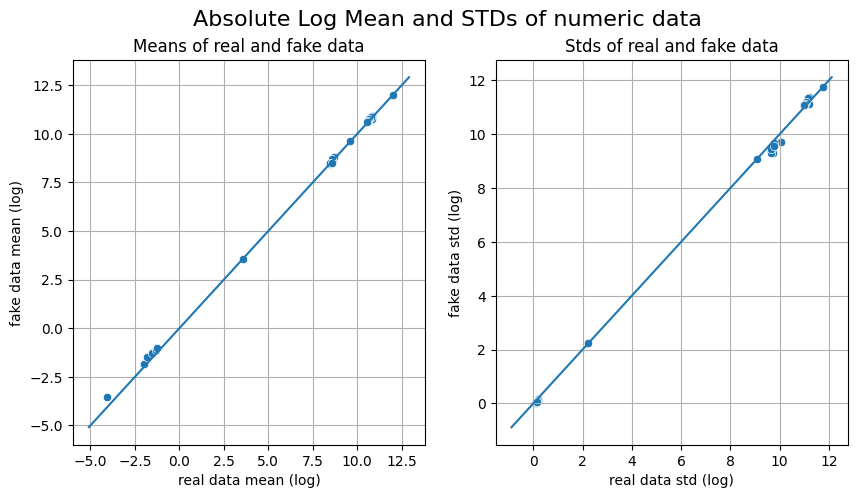

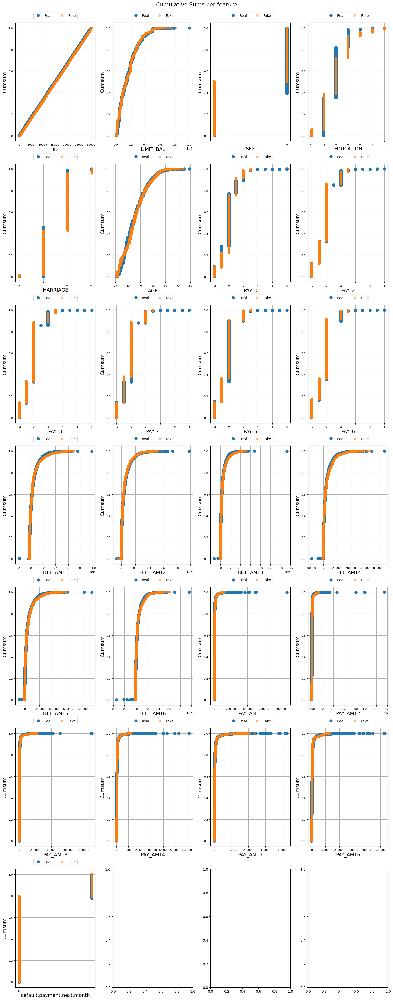

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\U

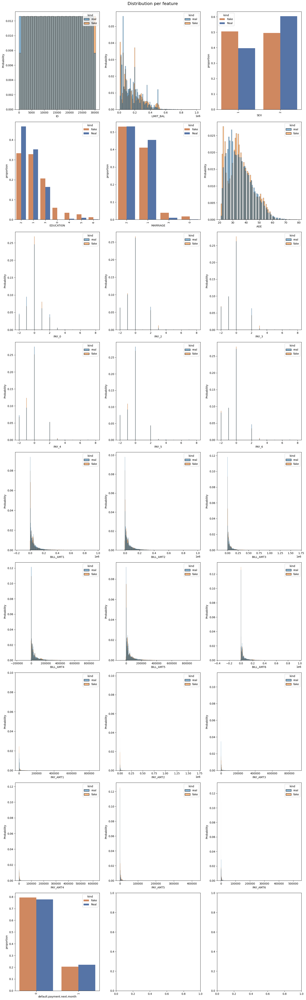

TypeError: Image data of dtype object cannot be converted to float

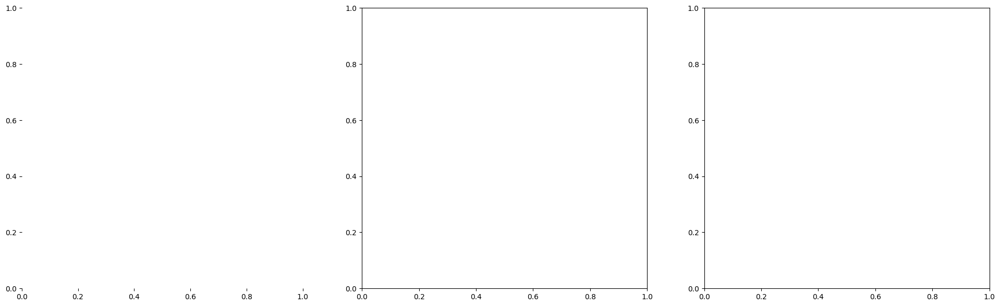

In [128]:
from table_evaluator import TableEvaluator
table_evaluator1 = TableEvaluator(real_data, synthetic_dataCTGAN, cat_cols=cat_cols)
table_evaluator1.visual_evaluation()

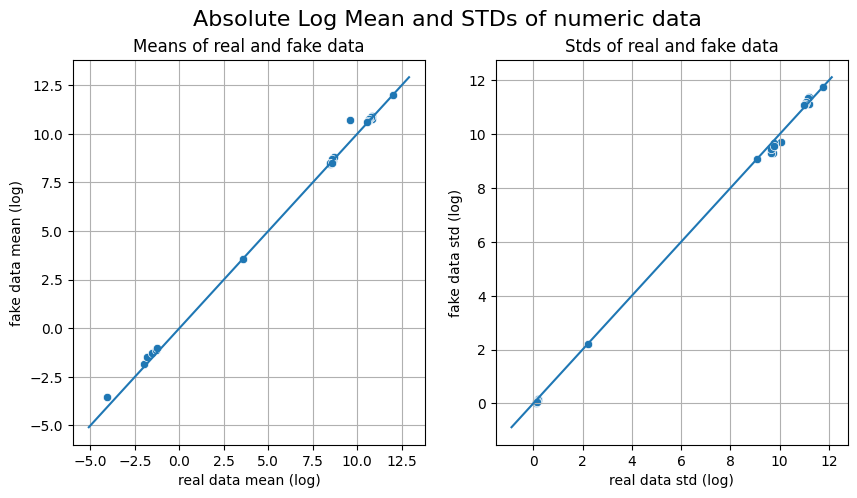

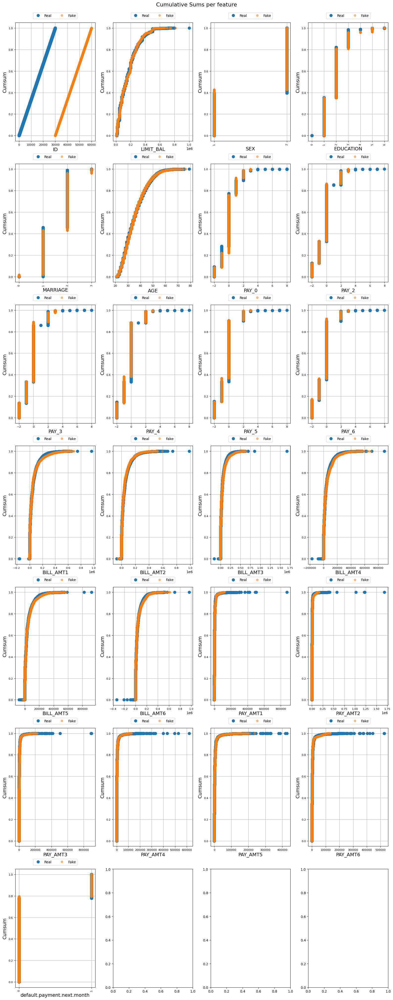

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\arnab\AppData\Local\Programs\Python\Python310\lib\site-packages\table_evaluator\table_evaluator.py:156: FutureWarning:

The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\U

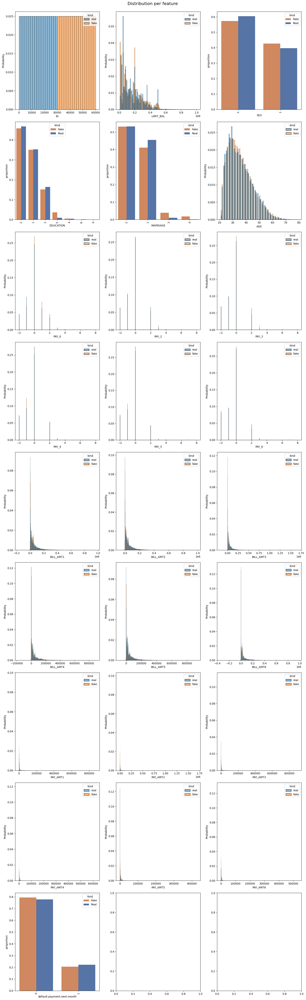

TypeError: Image data of dtype object cannot be converted to float

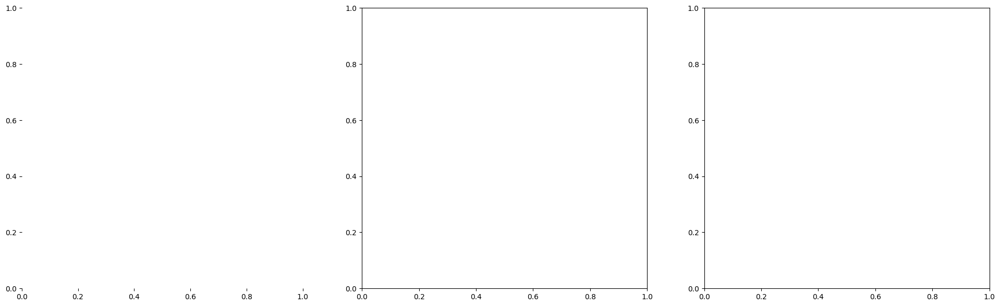

In [129]:
from table_evaluator import TableEvaluator
table_evaluator1 = TableEvaluator(real_data,reversed_dff , cat_cols=cat_cols)
table_evaluator1.visual_evaluation()

In [130]:
get_column_plot(
    real_data=real_data,
    synthetic_data=reversed_dff,
    column_name='AGE',
    metadata=metadata
)

## CONCLUSION:


1> Deep Learning algorithms perform better in overall score comparing to Gaussian Copula and CTGAN has the most accracies.
But for categorical columns CTGAN and TVAE performs really bad ,specially TVAE whereas GaussianCopula performs better for categorical variables in every aspect for this dataset.

2> GaussianCopula and TVAE has missed extreme values for most of the columns(as visualized) whereas CTGAN has shown a better result.

3>TVAE model missed more categories of data than GaussianCopula and CTGAN.

4>TVAE and CTGAN both miss  50% of numerical ranges of our data compared to GaussianCopula's 10%(?)

5>No model is able to predict kurtosis  well for all columns.

6> Gaussian Copula has a much lower time complexity compared to TVAE and CTGAN. Also we have more options to customize Gaussian Copula than TVAE and CTGAN.

Questions:
1> We take the average of KSComplement/TVComplement score of all columns as overall score .Is it good to predict the quality of combined all columns taking the average value?

2>We have calculated the correlation of two columns and don't know if correlation of more than two columns are perfectly captured.

3> How to define privacy and which metrics to use privacy? 
